# Cervix lugol/non-lugol imagery classification with a custom NN

In [1]:
# https://ipython.org/ipython-doc/3/config/extensions/autoreload.html
%load_ext autoreload
%autoreload 2

In [2]:
import os
from datetime import datetime
import numpy as np
import cv2
import warnings
warnings.filterwarnings("ignore")

# Project
import sys
sys.path.append(os.path.join(os.path.abspath(os.path.dirname('.')), '..', 'common'))

import matplotlib.pylab as plt
%matplotlib inline

def plt_st(n, m):
    plt.figure(figsize=(n, m))

## Define input data:

Lugol images and non-lugol (normal and green) images



In [3]:
seed = 12345
np.random.seed(seed)

In [4]:
from data_utils import RESOURCES_PATH, GENERATED_DATA, get_annotations
sloth_annotations_filename = os.path.join(RESOURCES_PATH, 'imagery_classification.json')
annotations = get_annotations(sloth_annotations_filename)
print(len(annotations))

2003


In [5]:
from data_utils import additional_type_1_ids, additional_type_2_ids, additional_type_3_ids

def get_lugol_nonlugol_trainval_id_type_lists(annotations, val_split=0.2, seed=2017):

    id_type_list = []
    n = len(annotations)
    additional_ids = [additional_type_1_ids, additional_type_2_ids, additional_type_3_ids]
    
    np.random.seed(seed)
    
    for i, annotation in enumerate(annotations):
        image_name = annotation['filename']
        image_id = os.path.basename(image_name)[:-4]
        splt = os.path.split(os.path.dirname(image_name))

        image_id_type_removed = False
        if os.path.basename(splt[0]).lower() == "train":
            image_type = splt[1]
        elif os.path.basename(splt[0]).lower() == "additional":
            image_type = "A" + splt[1]            
            # Check if image is not excluded:                    
            for i in range(3):             
                if image_type == "AType_%i" % (i+1) and image_id not in additional_ids[i]:
                    image_id_type_removed = True
                    break
        else:
            raise Exception("Unknown type : %s" % os.path.basename(splt[0]))                
        
        if image_id_type_removed:
            continue
        
        for label in annotation['annotations']:
            if label['class'] == u'Lugol iodine':
                id_type_list.append(((image_id, image_type), 1))
            else:
                id_type_list.append(((image_id, image_type), 0))

    np.random.shuffle(id_type_list)
    ll = int(len(id_type_list) * (1.0 - val_split))
    return id_type_list[:ll], id_type_list[ll:]

In [6]:
train_id_type_list, val_id_type_list = get_lugol_nonlugol_trainval_id_type_lists(annotations, val_split=0.25, seed=seed)

In [7]:
train_lugol_id_type_list = [(image_id, image_type) for ((image_id, image_type), target) in train_id_type_list if target == 1]
val_lugol_id_type_list = [(image_id, image_type) for ((image_id, image_type), target) in val_id_type_list if target == 1]
train_nonlugol_id_type_list = [(image_id, image_type) for ((image_id, image_type), target) in train_id_type_list if target == 0]
val_nonlugol_id_type_list = [(image_id, image_type) for ((image_id, image_type), target) in val_id_type_list if target == 0]

print len(train_id_type_list), len(val_id_type_list)
print len(train_lugol_id_type_list), len(val_lugol_id_type_list), len(train_nonlugol_id_type_list), len(val_nonlugol_id_type_list)

1491 498
539 177 952 321


In [8]:
assert len(set(train_lugol_id_type_list) & set(train_nonlugol_id_type_list)) == 0 
assert len(set(val_lugol_id_type_list) & set(val_nonlugol_id_type_list)) == 0 
assert len(set(train_lugol_id_type_list) & set(val_nonlugol_id_type_list)) == 0
assert len(set(val_lugol_id_type_list) & set(train_nonlugol_id_type_list)) == 0 

In [9]:
from image_utils import get_cervix_image, get_image_data


def display_all(id_type_list, title):
    tile_size = (224, 224)
    n = 15

    m = int(np.ceil(len(id_type_list) * 1.0 / n))
    complete_image = np.zeros((m*(tile_size[0]+2), n*(tile_size[1]+2), 3), dtype=np.uint8)
    counter = 0
    for i in range(m):
        ys = i*(tile_size[1] + 2)
        ye = ys + tile_size[1]
        for j in range(n):
            xs = j*(tile_size[0] + 2)
            xe = xs + tile_size[0]
            if counter == len(id_type_list):
                break
            image_id, image_type = id_type_list[counter]; counter+=1
            if counter % 50 == 0:
                print "--", counter, "/", len(id_type_list)
            img = get_cervix_image(image_id, image_type)
#             img = get_image_data(image_id, image_type)
            if img.shape[:2] != tile_size:
                img = cv2.resize(img, dsize=tile_size)
            img = cv2.putText(img, image_id + "|" + image_type, (5,img.shape[0] - 5), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (255, 255, 255), thickness=2)
            complete_image[ys:ye, xs:xe, :] = img[:,:,:]
        if counter == len(id_type_list):
            break   
            
    m = complete_image.shape[0] / (tile_size[0] + 2)
    n = int(np.ceil(m / 15.0))
    for i in range(n):
        plt_st(20, 20)
        ys = i*(tile_size[0] + 2)*15
        ye = min((i+1)*(tile_size[0] + 2)*15, complete_image.shape[0])
        plt.imshow(complete_image[ys:ye,:,:])
        plt.title(title)            

-- 50 / 571
-- 100 / 571
-- 150 / 571
-- 200 / 571
-- 250 / 571
-- 300 / 571
-- 350 / 571
-- 400 / 571
-- 450 / 571
-- 500 / 571
-- 550 / 571


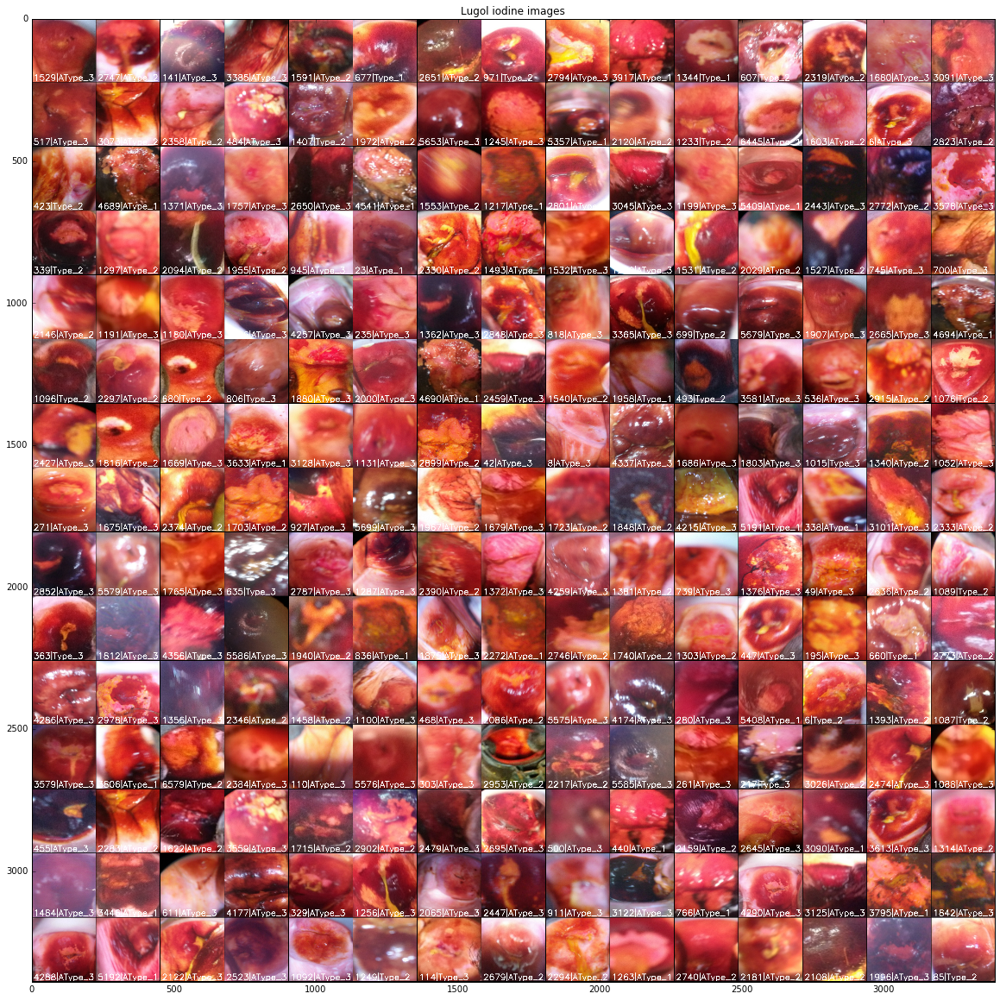

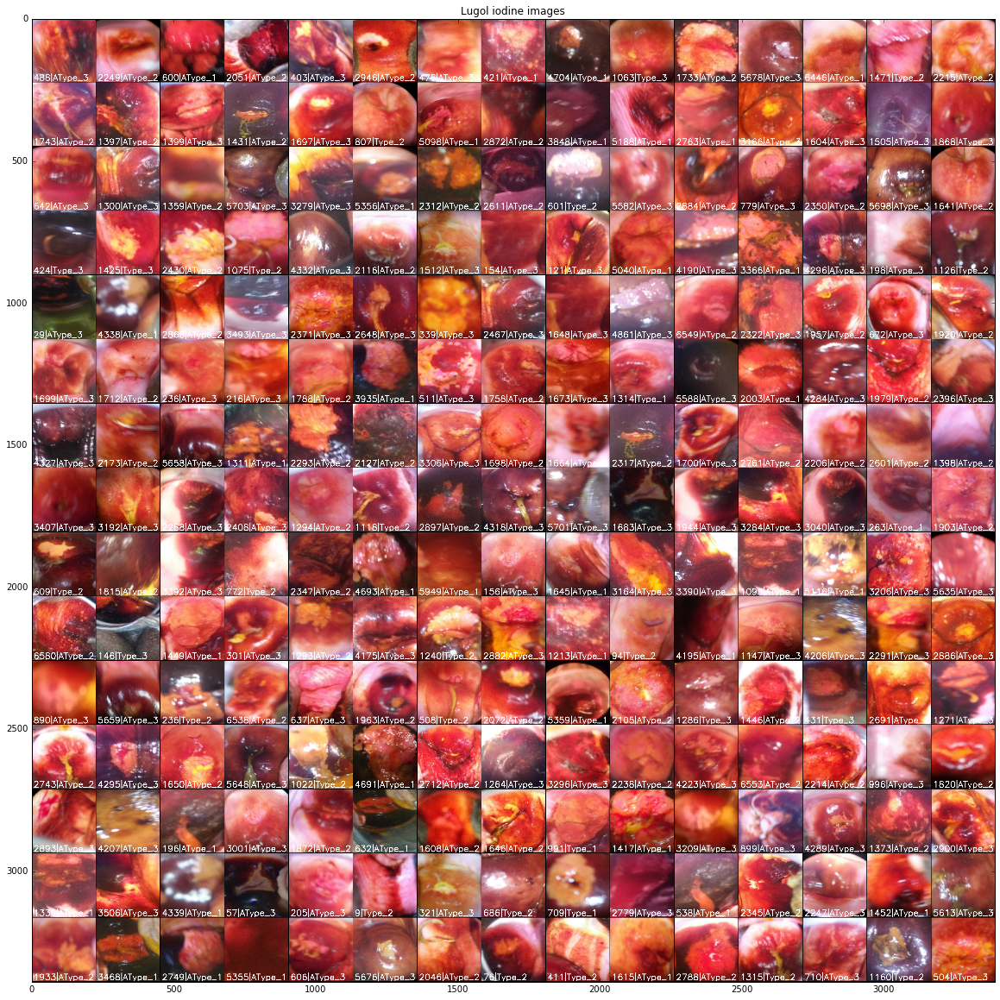

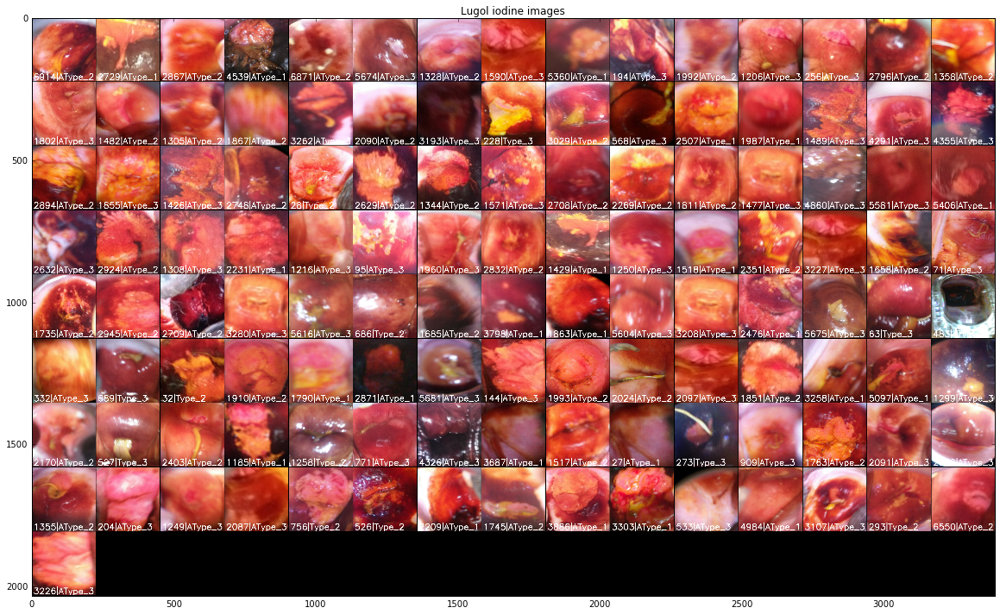

In [11]:
# id_type_list = list(train_lugol_id_type_list)
# id_type_list.extend(val_lugol_id_type_list)

# display_all(id_type_list, "Lugol iodine images")

-- 50 / 1182
-- 100 / 1182
-- 150 / 1182
-- 200 / 1182
-- 250 / 1182
-- 300 / 1182
-- 350 / 1182
-- 400 / 1182
-- 450 / 1182
-- 500 / 1182
-- 550 / 1182
-- 600 / 1182
-- 650 / 1182
-- 700 / 1182
-- 750 / 1182
-- 800 / 1182
-- 850 / 1182
-- 900 / 1182
-- 950 / 1182
-- 1000 / 1182
-- 1050 / 1182
-- 1100 / 1182
-- 1150 / 1182


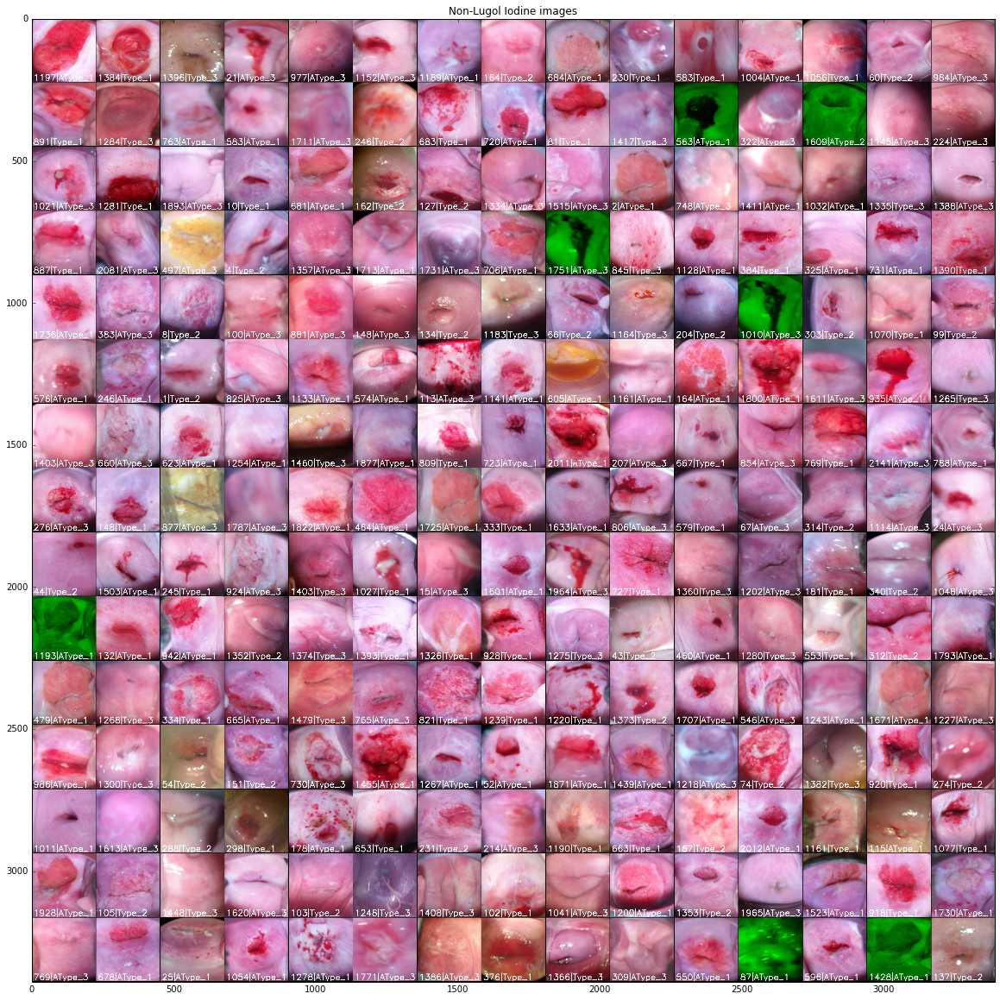

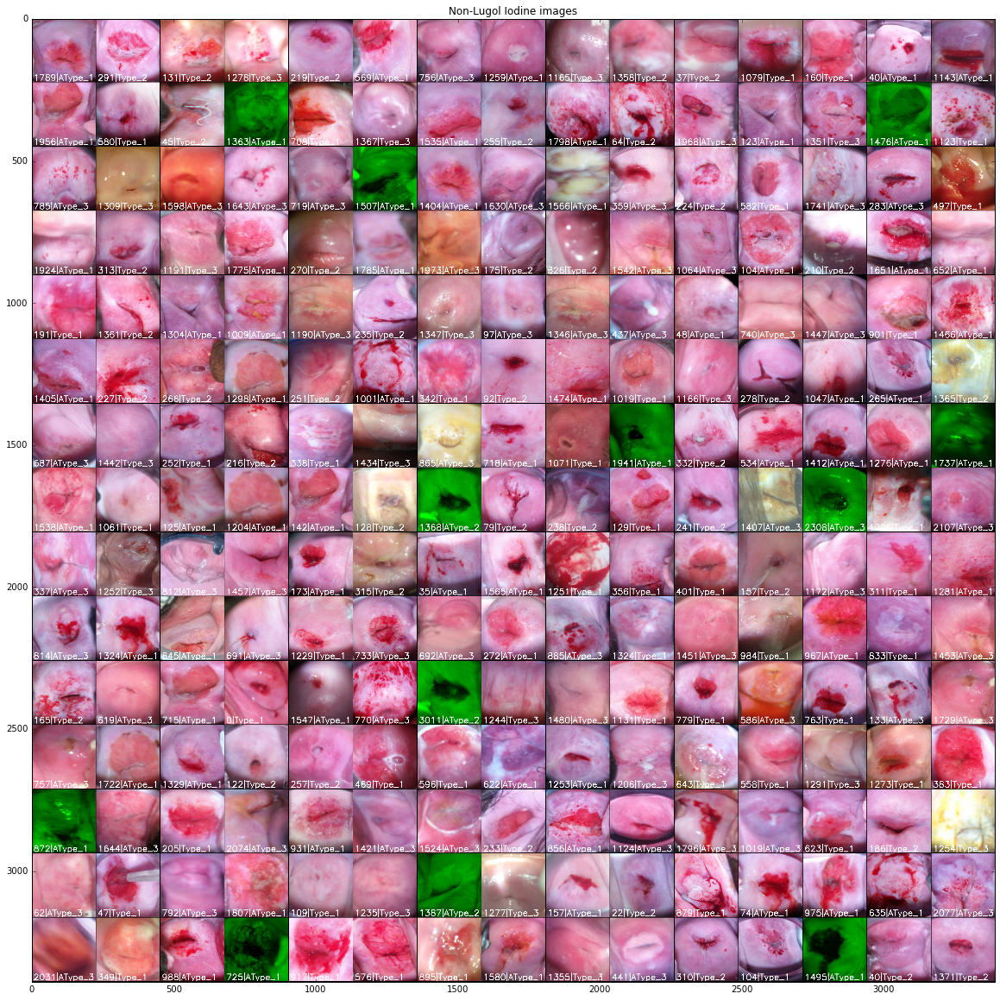

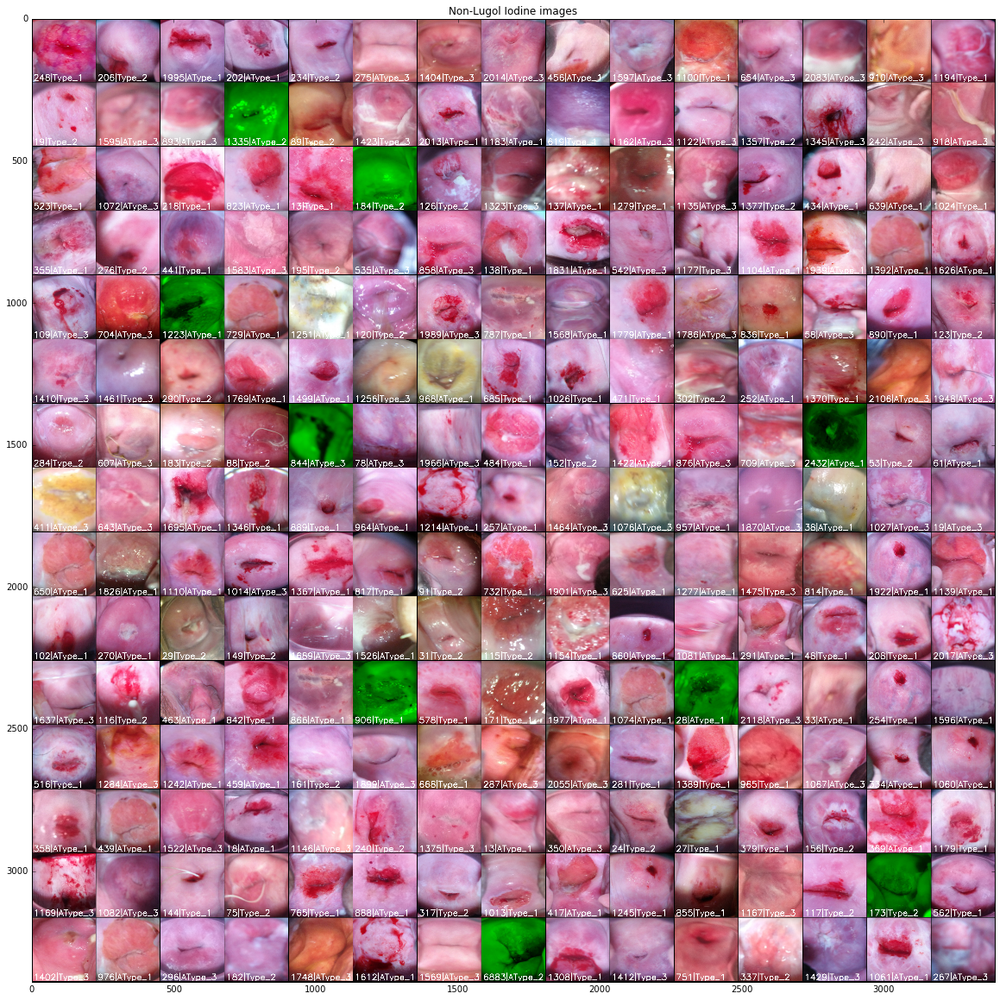

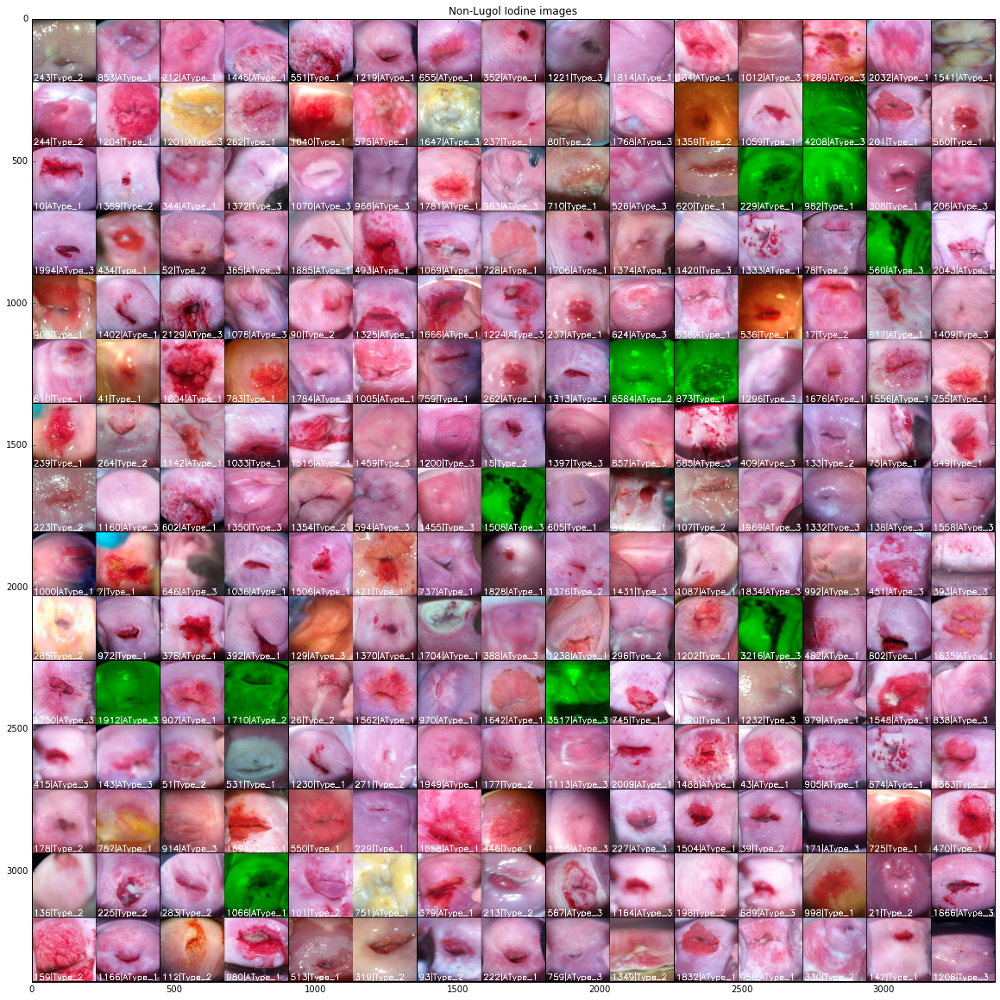

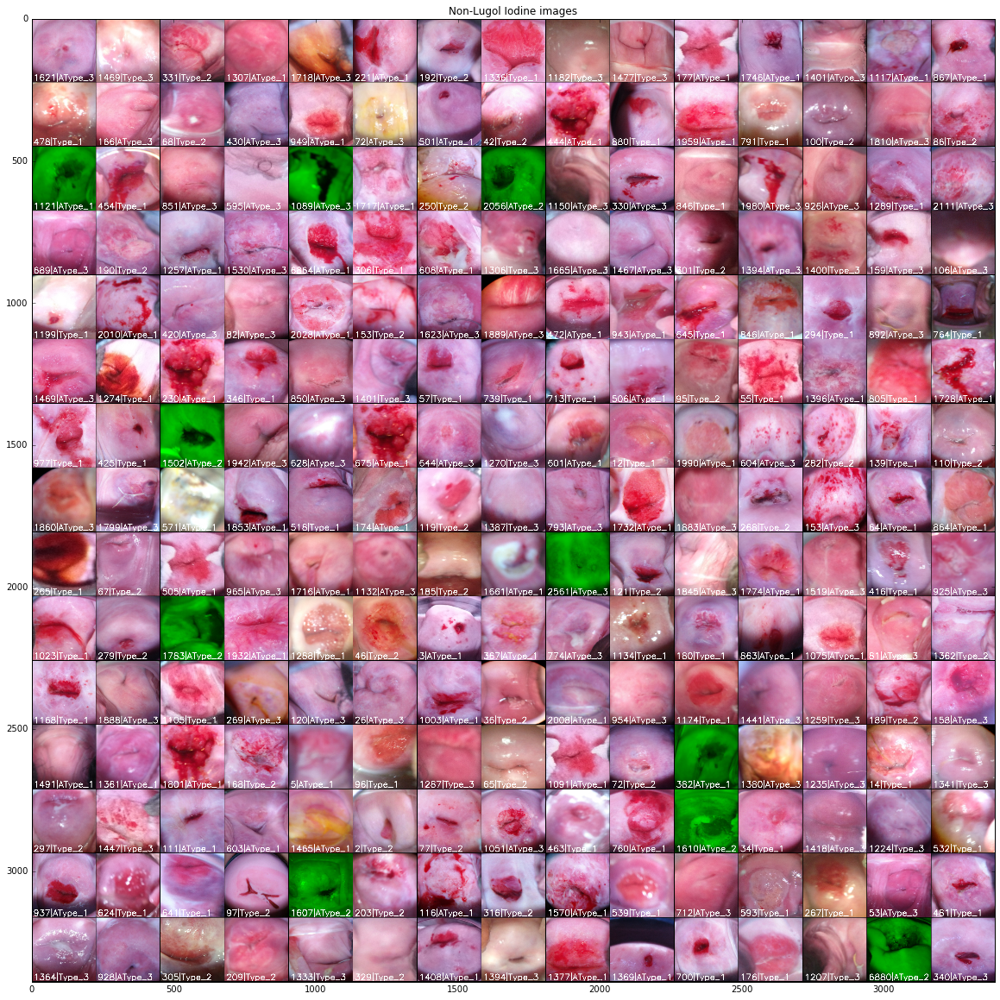

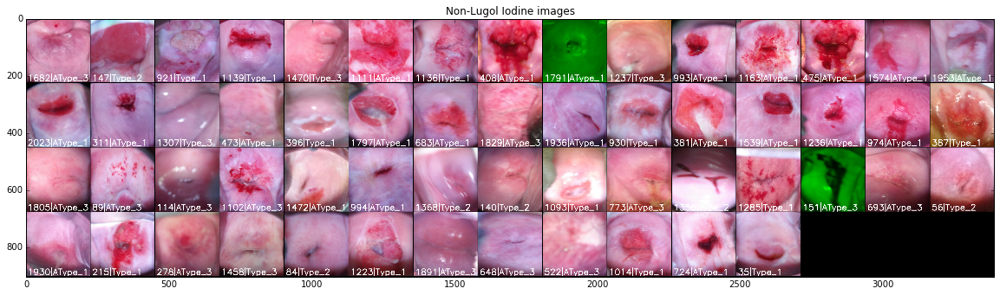

In [24]:
# id_type_list = list(train_nonlugol_id_type_list)
# id_type_list.extend(val_nonlugol_id_type_list)

# display_all(id_type_list, "Non-Lugol Iodine images")

## Define CNN

In [10]:
from imagery_classification.lugol_nonlugol import get_cnn

Using Theano backend.


Couldn't import dot_parser, loading of dot files will not be possible.


WARNING (theano.sandbox.cuda): The cuda backend is deprecated and will be removed in the next release (v0.10).  Please switch to the gpuarray backend. You can get more information about how to switch at this URL:
 https://github.com/Theano/Theano/wiki/Converting-to-the-new-gpu-back-end%28gpuarray%29

Using gpu device 0: GeForce GT 750M (CNMeM is enabled with initial size: 50.0% of memory, cuDNN 5110)


In [50]:
optimizer = 'adam'
lr_base = 0.001
cnn = get_cnn_1(optimizer=optimizer, lr=lr_base)

In [51]:
cnn.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_3 (InputLayer)             (None, 3, 299, 299)   0                                            
____________________________________________________________________________________________________
convolution2d_15 (Convolution2D) (None, 32, 149, 149)  896         input_3[0][0]                    
____________________________________________________________________________________________________
batchnormalization_15 (BatchNorm (None, 32, 149, 149)  128         convolution2d_15[0][0]           
____________________________________________________________________________________________________
activation_15 (Activation)       (None, 32, 149, 149)  0           batchnormalization_15[0][0]      
___________________________________________________________________________________________

## Train classifier

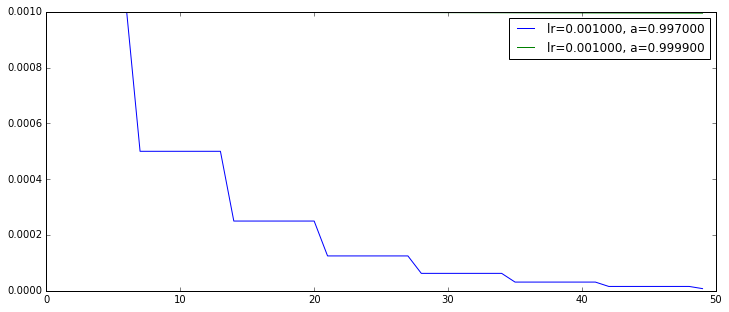

In [14]:
from training_utils import exp_decay, step_decay

lr_1 = 1.0 * lr_base; a_1 = 0.997
lr_2 = 1.0 * lr_base; a_2 = 0.9999

epochs = np.arange(0, 50)
lrs_1 = step_decay(epochs, lr=lr_1, period=7)
lrs_2 = exp_decay(epochs, lr=lr_2, a=a_2)
plt_st(12, 5)
plt.plot(epochs, lrs_1, label="lr=%f, a=%f" % (lr_1, a_1))
plt.plot(epochs, lrs_2, label="lr=%f, a=%f" % (lr_2, a_2))
plt.legend()

In [52]:
save_prefix='cervix_lugol_nonlugol_classification_1_opt=%s_seed=%i' % (optimizer, seed)

In [18]:
# from glob import glob
# from training_utils import find_best_weights_file

# weights_files = glob("weights/%s*.h5" % save_prefix)
# best_weights_filename, best_val_loss = find_best_weights_file(weights_files)
# print("Best val loss weights: ", best_weights_filename)

# if len(best_weights_filename) > 0:
#     # load weights to the model
#     print("Load found weights: ", best_weights_filename)
#     cnn.load_weights(best_weights_filename)

In [26]:
from xy_providers import DataCache
# cache = DataCache(0)
# cache_64x64 = DataCache(0)

In [19]:
class_weight = {
    0: len(train_nonlugol_id_type_list) * 1.0 / len(train_id_type_list),
    1: len(train_lugol_id_type_list) * 1.0 / len(train_id_type_list),    
}
class_weight

{0: 0.6384976525821596, 1: 0.3615023474178404}

In [53]:
from imagery_classification.lugol_nonlugol import train
      
nb_epochs = 25
batch_size = 32

lrate_decay_f = lambda epoch: step_decay(epoch, lr=lr_base, period=4) 

print("\n {} - Start training ...".format(datetime.now()))
h = train(cnn, 
          train_id_type_list, 
          val_id_type_list, 
          nb_epochs=nb_epochs,
          samples_per_epoch=2 * len(train_id_type_list),
          nb_val_samples=len(val_id_type_list),
          lrate_decay_f=lrate_decay_f,
          batch_size=batch_size,
          xy_provider_cache=cache,
          class_weight=class_weight,
          seed=seed,
          save_prefix=save_prefix)


 2017-04-30 20:45:18.603140 - Start training ...

-- Training parameters: 32, 25, 3008, 512

-- Fit stats of train dataset
1488/1491 [============================>.] - ETA: 0s
-- Fit model
Epoch 1/25
3008/3008 [==============================] - 49s - loss: 0.1965 - acc: 0.7832 - recall: 0.5885 - precision: 0.7572 - val_loss: 0.1958 - val_acc: 0.9375 - val_recall: 0.8832 - val_precision: 0.9459
Epoch 2/25
3008/3008 [==============================] - 48s - loss: 0.1264 - acc: 0.8923 - recall: 0.8225 - precision: 0.8725 - val_loss: 0.2358 - val_acc: 0.9141 - val_recall: 0.8918 - val_precision: 0.8706
Epoch 3/25
3008/3008 [==============================] - 46s - loss: 0.1209 - acc: 0.9029 - recall: 0.8440 - precision: 0.8932 - val_loss: 0.1709 - val_acc: 0.9453 - val_recall: 0.9551 - val_precision: 0.8881
Epoch 4/25
3008/3008 [==============================] - 45s - loss: 0.1041 - acc: 0.9202 - recall: 0.8790 - precision: 0.9025 - val_loss: 0.1957 - val_acc: 0.9336 - val_recall: 0.9463 - 

## Visual classification validation

In [28]:
# weights_files = glob("weights/%s*.h5" % save_prefix)
# best_weights_filename, best_val_loss = find_best_weights_file(weights_files, end_index=-11)
# print("Best val loss weights: ", best_weights_filename)

best_weights_filename="weights/cervix_lugol_nonlugol_classification_3_opt=adam_seed=12345_17_val_loss=0.1048_val_acc=0.9609_val_precision=0.9525_val_recall=0.9419.h5"

if len(best_weights_filename) > 0:
    # load weights to the model
    print("Load found weights: ", best_weights_filename)
    cnn.load_weights(best_weights_filename)

('Load found weights: ', 'weights/cervix_lugol_nonlugol_classification_3_opt=adam_seed=12345_17_val_loss=0.1048_val_acc=0.9609_val_precision=0.9525_val_recall=0.9419.h5')


In [30]:
from data_utils import GENERATED_DATA
from image_utils import scale_percentile
from preprocessing.image.generators import ImageDataGenerator
from imagery_classification.lugol_nonlugol import cached_image_label_provider

batch_size = 4

normalize_data = True
image_size = (299, 299)
channels_first = True

xy_provider = cached_image_label_provider
val_gen = ImageDataGenerator(featurewise_center=normalize_data,
                             featurewise_std_normalization=normalize_data)

if normalize_data:
    assert len(save_prefix) > 0, "WTF"
    # Load mean, std, principal_components if file exists
    filename = os.path.join(GENERATED_DATA, save_prefix + "_stats.npz")
    assert os.path.exists(filename), "WTF"
    print("Load existing file: %s" % filename)
    npzfile = np.load(filename)
    val_gen.mean = npzfile['mean']
    val_gen.std = npzfile['std']
        
        
        
flow = val_gen.flow(xy_provider(val_id_type_list,
                                image_size=image_size,
                                channels_first=channels_first,
                                cache=cache,
                                test_mode=True),
                    # Ensure that all batches have the same size
                    len(val_id_type_list),
                    batch_size=batch_size)
total_counter = 0

Load existing file: /Users/vfomin/Documents/ML/Kaggle/Intel_MobileODT/input/generated/cervix_lugol_nonlugol_classification_3_opt=adam_seed=12345_stats.npz


(4, 3, 299, 299)
('--', 60)
((u'998', u'Type_1'), array([ 0.85429937], dtype=float32), array([0]))
((u'740', u'AType_3'), array([ 0.00179783], dtype=float32), array([0]))
((u'171', u'AType_3'), array([  3.64452580e-06], dtype=float32), array([0]))
((u'5574', u'AType_3'), array([ 0.98842174], dtype=float32), array([1]))


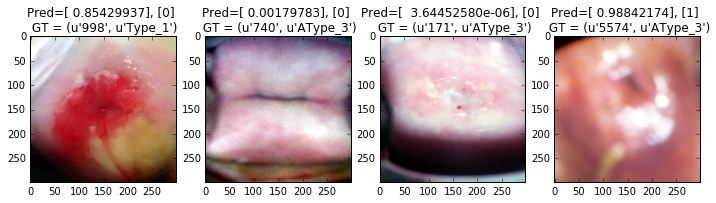

In [45]:
for x, y_true, info in flow:
    print x.shape    
    s = y_true.shape[0]
    y_pred = cnn.predict(x)
    print("--", total_counter*batch_size + s)    
    total_counter += 1
    plt_st(12, 4)
    for i in range(s):
        print(info[i], y_pred[i], y_true[i])
        plt.subplot(1, s, i+1)
        plt.title("Pred={}, {} \n GT = {}".format(y_pred[i], y_true[i], info[i]))
        plt.imshow(scale_percentile(x[i, :, :, :].transpose([1, 2, 0])))
    break

## Train final model

In [48]:
# nb_epochs = 10
# batch_size = 32
# lr_base = 0.000001
# lrate_decay_f = lambda epoch: step_decay(epoch, lr=lr_base, period=3) 
# save_prefix='cervix_lugol_nonlugol_classification_3_opt=%s_seed=%i' % (optimizer, seed)

# id_type_list = list(train_id_type_list)
# id_type_list.extend(val_id_type_list)

# h = train(cnn, 
#           id_type_list, 
#           val_id_type_list=None, 
#           nb_epochs=nb_epochs,
#           samples_per_epoch=len(id_type_list),
#           nb_val_samples=None,
#           lrate_decay_f=lrate_decay_f,
#           batch_size=batch_size,
#           xy_provider_cache=cache,
#           class_weight=class_weight,
#           seed=seed,
#           save_prefix=save_prefix)

In [49]:
from data_utils import test_ids
from image_utils import get_cervix_image
from training_utils import get_all_trainval_id_type_list
from imagery_classification.green import is_green_type

all_trainval_id_type_list = get_all_trainval_id_type_list(n_images_per_class=-1)

test_id_type_list = []
for image_id in test_ids:
    test_id_type_list.append((image_id, "Test"))
    
print("Length of all_trainval_id_type_list:", len(all_trainval_id_type_list))
print("Length of test_id_type_list:", len(test_id_type_list))

('Length of all_trainval_id_type_list:', 7060)
('Length of test_id_type_list:', 512)


In [ ]:
from data_utils import get_filename
from xy_providers import cached_image_provider as xy_provider

def _setup_model(save_prefix):
    # Load weights
    weights_files = glob("weights/%s*.h5" % save_prefix)
    best_weights_filename, best_val_loss = find_best_weights_file(weights_files)
    print("Best val loss weights: ", best_weights_filename)

    if len(best_weights_filename) > 0:
        # load weights to the model
        print("Load found weights: ", best_weights_filename)
        unet.load_weights(best_weights_filename)
        

def _get_generator(save_prefix):
    # Initialize generator
    gen = ImageDataGenerator(featurewise_center=True, featurewise_std_normalization=True)

    # Load mean, std, principal_components if file exists
    filename = os.path.join(GENERATED_DATA, save_prefix + "_stats.npz")
    assert os.path.exists(filename), "WTF"
    print("Load existing file: %s" % filename)
    npzfile = np.load(filename)
    gen.mean = npzfile['mean']
    gen.std = npzfile['std']
    return gen


# def generate_test_os_cervix_masks(save_prefix, model_index):
#     batch_size = 16
#     _setup_model(save_prefix)        
#     gen = _get_generator(save_prefix, batch_size)            
#     # Iterate over data and predict
#     flow = gen.flow(xy_provider(test_id_type_list,
#                             cache=cache,
#                             image_size=(224, 224)),
#                 # Ensure that all batches have the same size
#                 len(test_id_type_list),
#                 batch_size=batch_size)
#     counter = 1
#     ll = len(test_id_type_list)
#     for x, _, info in flow:               
#         y_pred = unet.predict(x)   
#         for i in range(y_pred.shape[0]):
#             print('-- %i / %i : %s, %s' % (counter, ll, info[i][0], info[i][1]))        
#             image_id = info[i][0] + '_' + info[i][1]
#             counter += 1
#             if os.path.exists(get_filename(image_id, 'os_cervix_label_%i' % model_index)):
#                 continue
#             imwrite(y_pred[i, :, :, :].transpose([1, 2, 0]), image_id, 'os_cervix_label_%i' % model_index)

            
def generate_lugol_nonlugol_id_type_list(save_prefix, model_index):
    image_size=(224, 224)
    batch_size = 16
    net = _setup_model(save_prefix)        
    gen = _get_generator(save_prefix, batch_size)            
    # Iterate over data and predict
    flow = gen.flow(xy_provider(all_trainval_id_type_list,
                            cache=cache,
                            image_size=image_size),
                # Ensure that all batches have the same size
                len(all_trainval_id_type_list),
                batch_size=batch_size)
    
    counter = 1
    ll = len(all_trainval_id_type_list)
    for x, _, info in flow:
        
        can_continue = True
        for i in range(info.shape[0]):
            image_id = info[i][0] + '_' + info[i][1]
            if not os.path.exists(get_filename(image_id, 'os_cervix_label_%i' % model_index)):
                can_continue = False
        if can_continue:            
            for i in range(info.shape[0]):
                print('-- %i / %i : %s, %s' % (counter, ll, info[i][0], info[i][1]))    
                counter += 1 
            continue
        
        y_pred = unet.predict(x)   
        for i in range(y_pred.shape[0]):
            print('-- %i / %i : %s, %s' % (counter, ll, info[i][0], info[i][1]))        
            counter += 1
            image_id = info[i][0] + '_' + info[i][1]
            if os.path.exists(get_filename(image_id, 'os_cervix_label_%i' % model_index)):
                continue
            imwrite(y_pred[i, :, :, :].transpose([1, 2, 0]), image_id, 'os_cervix_label_%i' % model_index)
            

Model 2

In [ ]:


best_weights_filename="weights/cervix_lugol_nonlugol_classification_3_opt=adam_seed=12345_17_val_loss=0.1048_val_acc=0.9609_val_precision=0.9525_val_recall=0.9419.h5"

if len(best_weights_filename) > 0:
    # load weights to the model
    print("Load found weights: ", best_weights_filename)
    cnn.load_weights(best_weights_filename)